# **Final Project: Boston Crime Incident Reports**
---
# *Cristina Pellegrino and Tyler Sirowich*

![Boston Map](https://cdn.shopify.com/s/files/1/0078/2472/products/boston_type_map_rainbow_large_1024x1024.png?v=1392723694)





## **Table of Contents**
---
- [Section 1: Overview](#scrollTo=pIVZJvNWIjoi&line=1&uniqifier=1)
- [Section 2: Study the Data](#scrollTo=G7OUJBqoI8IH&line=1&uniqifier=1)
- [Section 3: Clean the Data](#scrollTo=50z7aDODJSQ7&line=1&uniqifier=1)
- [Section 4: Describe the Data](#scrollTo=twYTM6zvKFXp&line=1&uniqifier=1)
- [Section 5: Feature Transformation and Creation](#scrollTo=z_FGRoc_u_Sy&line=1&uniqifier=1)
- [Section 6: Analysis](#scrollTo=0haYl6rxKJSR&line=1&uniqifier=1)
- [Section 7: Conclusion](#scrollTo=0DzHcvP8KMn0&line=1&uniqifier=1)

## ***Section 1: Overview***
---
A college students plans on moving to Boston post graduation to begin a career. The student is unfamiliar with the area, and is trying to learn more about the area for safety reasons. The student wants to know what areas crimes are most prevalent in and the time they are most likely to occur in order to be extra cautious. 

### **Project Objectives and Research Questions**
---
#### ***Preliminary Questions***
*   Do most incidents involve a shooting?
*   Have crime incidents increased or decreased over the past few years?
*   What months have the highest occurrences of crime incidents?
*   What days of the week have the most crime incidents reported? 
*   What hour of the day has the most crime incidents reported?

#### ***Further Research Questions***
*   What season has the most crime incidents reported? 
*   Are crime incidents at specific hours more prevalent in certain seasons?
*   Have different years observed different patterns in terms of monthly counts of crime incident reports?
*   Do weekends or weekdays have more crime incidents reported?
*   What area has the highest concentration of crime incident reports?



### **Data Sources**
---

[Kaggle: Crimes in Boston](https://www.kaggle.com/AnalyzeBoston/crimes-in-boston)

### **Library Glossary**
---
*   Numpy: Numpy stands for numeric python. It is useful in working with arrays and provides many mathematical functions.
*   Pandas: Provides functions for data manipulation and analysis of data structures.
*   Matplotlib: Plotting library for python that helps create static and interactive visualizations.
*   Seaborn: Provides visualizations based off of Matplotlib at a higher level.
*   Geopandas: Allows pandas to be able to operate on geospatial data and also allows for the work of shapely files.
*   Folium: Library used to help visualize geopsatial data.









In [2]:

!pip install geopandas
!pip install gmaps
!pip install folium

     |████████████████████████████████| 972kB 12.7MB/s 
     |████████████████████████████████| 14.8MB 320kB/s 
     |████████████████████████████████| 6.5MB 45.1MB/s 
     |████████████████████████████████| 1.1MB 12.2MB/s 
  Created wheel for gmaps: filename=gmaps-0.9.0-py2.py3-none-any.whl size=2076096 sha256=c38bc6219ce8fb6a36d6817976f1b746b3c5678e48eac8181ed30ca2a599ee19
  Stored in directory: /root/.cache/pip/wheels/33/eb/41/5302168c36fc8ce8f48143bb58fde1015d5bc0c62bc3ddbb38
Successfully built gmaps


In [3]:
#Import Packages
%matplotlib inline
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import geopandas as gpd
import folium
import gmaps
from folium import features
from folium.plugins import HeatMap
from folium.plugins import MarkerCluster
from IPython.display import display


plt.style.use('fivethirtyeight')



## ***Section 2: Study the Data***
---


###Import the Data

In [4]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [5]:
#bostoncrime = pd.read_csv('/content/drive/MyDrive/python final/tmpmtmwej29.csv')
bostoncrime = pd.read_csv('/content/drive/MyDrive/Graduate/Python for Business Analytics/Final Project: Boston/bostoncrimedata.csv')

/usr/local/lib/python3.6/dist-packages/IPython/core/interactiveshell.py:2718: DtypeWarning: Columns (0,2,6,12) have mixed types.Specify dtype option on import or set low_memory=False.
  interactivity=interactivity, compiler=compiler, result=result)


###Feature Description and Initial Review

| Feature Name | Definition | Key |
| ------------ | ---------- | --- |
| INCIDENT_NUMBER | _Unique Identifier_ | ... |
| OFFENSE_CODE | _..._ | ... |
| OFFENSE_CODE_GROUP | _..._ | ... | 
| OFFENSE_DESCRIPTION | _..._ | ..._ |
| DISTRICT | _..._ | ... |
| REPORTING_AREA | _..._ | ... |
| SHOOTING | _Shooting Occurence_ | __0 = No, 1 = Yes__  |
| OCCURRED_ON_DATE | ...  | ... |
| YEAR | ...  | ... |
| MONTH | ...  | ... |
| DAY_OF_WEEK | ...  | ...  |
| HOUR | ... | ... |
| UCR_PART | _..._ | ... |
| STREET | ... | ... |
| Lat | _Latitude_ | ... |
| Long | _Longitude_ | ... |
| Location | _Latitude,Longitude_ | ... |

In [6]:
bostoncrime.head()

,INCIDENT_NUMBER,OFFENSE_CODE,OFFENSE_CODE_GROUP,OFFENSE_DESCRIPTION,DISTRICT,REPORTING_AREA,SHOOTING,OCCURRED_ON_DATE,YEAR,MONTH,DAY_OF_WEEK,HOUR,UCR_PART,STREET,Lat,Long,Location
0,TESTTEST2,423,NaN,ASSAULT - AGGRAVATED,External,,0,2019-10-16 00:00:00,2019,10,Wednesday,0,NaN,RIVERVIEW DR,NaN,NaN,"(0.00000000, 0.00000000)"
1,S97333701,3301,NaN,VERBAL DISPUTE,C6,915,0,2020-07-18 14:34:00,2020,7,Saturday,14,NaN,MARY BOYLE WAY,42.330813,-71.051368,"(42.33081300, -71.05136800)"
2,S47513131,2647,NaN,THREATS TO DO BODILY HARM,E18,530,0,2020-06-24 10:15:00,2020,6,Wednesday,10,NaN,READVILLE ST,42.239491,-71.135954,"(42.23949100, -71.13595400)"
3,I92102201,3301,NaN,VERBAL DISPUTE,E13,583,0,2019-12-20 03:08:00,2019,12,Friday,3,NaN,DAY ST,42.325122,-71.107779,"(42.32512200, -71.10777900)"
4,I92097173,3115,NaN,INVESTIGATE PERSON,C11,355,0,2019-10-23 00:00:00,2019,10,Wednesday,0,NaN,GIBSON ST,42.297555,-71.059709,"(42.29755500, -71.05970900)"


In [7]:
bostoncrime.shape

(531942, 17)

In [8]:
bostoncrime.columns

Index(['INCIDENT_NUMBER', 'OFFENSE_CODE', 'OFFENSE_CODE_GROUP',
       'OFFENSE_DESCRIPTION', 'DISTRICT', 'REPORTING_AREA', 'SHOOTING',
       'OCCURRED_ON_DATE', 'YEAR', 'MONTH', 'DAY_OF_WEEK', 'HOUR', 'UCR_PART',
       'STREET', 'Lat', 'Long', 'Location'],
      dtype='object')

## ***Section 3: Clean the Data***
---

###Missing Values

In [9]:
#Check the count of missing data entries for each column
bostoncrime.isna().sum()


INCIDENT_NUMBER             0
OFFENSE_CODE                0
OFFENSE_CODE_GROUP     105103
OFFENSE_DESCRIPTION         0
DISTRICT                 2467
REPORTING_AREA              0
SHOOTING               425093
OCCURRED_ON_DATE            0
YEAR                        0
MONTH                       0
DAY_OF_WEEK                 0
HOUR                        0
UCR_PART               105213
STREET                  21682
Lat                     30249
Long                    30249
Location                    0
dtype: int64

In [10]:
#Check the percentage of missing data in each column
(bostoncrime.isna().sum()/bostoncrime.shape[0]).round(4) * 100

INCIDENT_NUMBER         0.00
OFFENSE_CODE            0.00
OFFENSE_CODE_GROUP     19.76
OFFENSE_DESCRIPTION     0.00
DISTRICT                0.46
REPORTING_AREA          0.00
SHOOTING               79.91
OCCURRED_ON_DATE        0.00
YEAR                    0.00
MONTH                   0.00
DAY_OF_WEEK             0.00
HOUR                    0.00
UCR_PART               19.78
STREET                  4.08
Lat                     5.69
Long                    5.69
Location                0.00
dtype: float64

In [11]:
#Fill missing data with mean
bostoncrime['Lat'].fillna((bostoncrime['Lat'].mean()), inplace=True)
bostoncrime['Long'].fillna((bostoncrime['Long'].mean()), inplace=True)

In [12]:
#Check the percentage of missing data in each column
(bostoncrime.isna().sum()/bostoncrime.shape[0]).round(4) * 100

INCIDENT_NUMBER         0.00
OFFENSE_CODE            0.00
OFFENSE_CODE_GROUP     19.76
OFFENSE_DESCRIPTION     0.00
DISTRICT                0.46
REPORTING_AREA          0.00
SHOOTING               79.91
OCCURRED_ON_DATE        0.00
YEAR                    0.00
MONTH                   0.00
DAY_OF_WEEK             0.00
HOUR                    0.00
UCR_PART               19.78
STREET                  4.08
Lat                     0.00
Long                    0.00
Location                0.00
dtype: float64

In [13]:
#Drop columns that are not needed for the analysis
bostoncrime = bostoncrime.drop(['OFFENSE_CODE','OFFENSE_CODE_GROUP','UCR_PART','REPORTING_AREA'], axis=1)
bostoncrime.head()

,INCIDENT_NUMBER,OFFENSE_DESCRIPTION,DISTRICT,SHOOTING,OCCURRED_ON_DATE,YEAR,MONTH,DAY_OF_WEEK,HOUR,STREET,Lat,Long,Location
0,TESTTEST2,ASSAULT - AGGRAVATED,External,0,2019-10-16 00:00:00,2019,10,Wednesday,0,RIVERVIEW DR,42.241604,-70.953611,"(0.00000000, 0.00000000)"
1,S97333701,VERBAL DISPUTE,C6,0,2020-07-18 14:34:00,2020,7,Saturday,14,MARY BOYLE WAY,42.330813,-71.051368,"(42.33081300, -71.05136800)"
2,S47513131,THREATS TO DO BODILY HARM,E18,0,2020-06-24 10:15:00,2020,6,Wednesday,10,READVILLE ST,42.239491,-71.135954,"(42.23949100, -71.13595400)"
3,I92102201,VERBAL DISPUTE,E13,0,2019-12-20 03:08:00,2019,12,Friday,3,DAY ST,42.325122,-71.107779,"(42.32512200, -71.10777900)"
4,I92097173,INVESTIGATE PERSON,C11,0,2019-10-23 00:00:00,2019,10,Wednesday,0,GIBSON ST,42.297555,-71.059709,"(42.29755500, -71.05970900)"


In [14]:
#Edit the shooting column to have uniform entries
bostoncrime['SHOOTING'] = np.where(bostoncrime['SHOOTING']==1,'Yes',np.where(bostoncrime['SHOOTING']=='Y','Yes','No'))


In [15]:
#Check the percentage of missing data in each column
(bostoncrime.isna().sum()/bostoncrime.shape[0]).round(4) * 100

INCIDENT_NUMBER        0.00
OFFENSE_DESCRIPTION    0.00
DISTRICT               0.46
SHOOTING               0.00
OCCURRED_ON_DATE       0.00
YEAR                   0.00
MONTH                  0.00
DAY_OF_WEEK            0.00
HOUR                   0.00
STREET                 4.08
Lat                    0.00
Long                   0.00
Location               0.00
dtype: float64

In [16]:
#Test to make sure the shotting column has no missing entries
assert (bostoncrime['SHOOTING'].isna().sum()/bostoncrime['SHOOTING'].shape[0]).round(4) * 100 == 0

###Data Types

In [17]:
#Check data types
bostoncrime.dtypes

INCIDENT_NUMBER         object
OFFENSE_DESCRIPTION     object
DISTRICT                object
SHOOTING                object
OCCURRED_ON_DATE        object
YEAR                     int64
MONTH                    int64
DAY_OF_WEEK             object
HOUR                     int64
STREET                  object
Lat                    float64
Long                   float64
Location                object
dtype: object

In [18]:
#Convert lat and long to objects 
bostoncrime[['Lat','Long']] = bostoncrime[['Lat','Long']].astype(object)

In [19]:
bostoncrime.dtypes

INCIDENT_NUMBER        object
OFFENSE_DESCRIPTION    object
DISTRICT               object
SHOOTING               object
OCCURRED_ON_DATE       object
YEAR                    int64
MONTH                   int64
DAY_OF_WEEK            object
HOUR                    int64
STREET                 object
Lat                    object
Long                   object
Location               object
dtype: object

###Sort Values

In [20]:
#Sort data by the date it occurred
bostoncrime.sort_values(by='OCCURRED_ON_DATE')

,INCIDENT_NUMBER,OFFENSE_DESCRIPTION,DISTRICT,SHOOTING,OCCURRED_ON_DATE,YEAR,MONTH,DAY_OF_WEEK,HOUR,STREET,Lat,Long,Location
410587,I152067251,FRAUD - FALSE PRETENSE / SCHEME,A1,No,2015-06-15 00:00:00,2015,6,Monday,0,FANEUIL HALL SQ,42.3602,-71.0562,"(42.36020464, -71.05620816)"
425075,I152051083,SEARCH WARRANT,A7,No,2015-06-15 00:00:00,2015,6,Monday,0,PARIS ST,42.377,-71.0322,"(42.37702319, -71.03224730)"
425076,I152051083,INVESTIGATE PERSON,A7,No,2015-06-15 00:00:00,2015,6,Monday,0,PARIS ST,42.377,-71.0322,"(42.37702319, -71.03224730)"
236266,I172040657,HARASSMENT,C11,No,2015-06-15 00:00:00,2015,6,Monday,0,MELBOURNE ST,42.2911,-71.0659,"(42.29109287, -71.06594539)"
115007,I182061268,PROPERTY - LOST,NaN,No,2015-06-15 00:00:00,2015,6,Monday,0,BERNARD,-1,-1,"(-1.00000000, -1.00000000)"
...,...,...,...,...,...,...,...,...,...,...,...,...,...
426940,202086622,ASSAULT - AGGRAVATED,C11,No,2020-11-24 02:47:00,2020,11,Tuesday,2,DORCHESTER AV,42.2416,-70.9536,"(0.00000000, 0.00000000)"
426937,202086625,VERBAL DISPUTE,E13,No,2020-11-24 03:36:00,2020,11,Tuesday,3,WASHINGTON ST,42.2416,-70.9536,"(0.00000000, 0.00000000)"
426935,202086627,VANDALISM,A1,No,2020-11-24 03:52:00,2020,11,Tuesday,3,WASHINGTON ST,42.2416,-70.9536,"(0.00000000, 0.00000000)"
426936,202086626,SICK ASSIST - DRUG RELATED ILLNESS,D4,No,2020-11-24 03:55:00,2020,11,Tuesday,3,BERKELEY ST,42.2416,-70.9536,"(0.00000000, 0.00000000)"


## ***Section 4: Describe Data***
---

###Overall

In [21]:
bostoncrime.describe(include='all')

,INCIDENT_NUMBER,OFFENSE_DESCRIPTION,DISTRICT,SHOOTING,OCCURRED_ON_DATE,YEAR,MONTH,DAY_OF_WEEK,HOUR,STREET,Lat,Long,Location
count,531942,531942,529475,531942,531942,531942.000000,531942.000000,531942,531942.000000,510260,531942.000000,531942.000000,531942
unique,480691,284,13,2,392366,NaN,NaN,7,NaN,5425,31707.000000,31553.000000,32574
top,I152071596,INVESTIGATE PERSON,B2,No,2016-08-01 00:00:00,NaN,NaN,Friday,NaN,WASHINGTON ST,42.241604,-70.953611,"(0.00000000, 0.00000000)"
freq,20,33357,84322,528953,33,NaN,NaN,80990,NaN,28139,30249.000000,30249.000000,30250
mean,NaN,NaN,NaN,NaN,NaN,2017.620788,6.743771,NaN,13.068432,NaN,NaN,NaN,NaN
std,NaN,NaN,NaN,NaN,NaN,1.578471,3.324024,NaN,6.352363,NaN,NaN,NaN,NaN
min,NaN,NaN,NaN,NaN,NaN,2015.000000,1.000000,NaN,0.000000,NaN,NaN,NaN,NaN
25%,NaN,NaN,NaN,NaN,NaN,2016.000000,4.000000,NaN,9.000000,NaN,NaN,NaN,NaN
50%,NaN,NaN,NaN,NaN,NaN,2018.000000,7.000000,NaN,14.000000,NaN,NaN,NaN,NaN
75%,NaN,NaN,NaN,NaN,NaN,2019.000000,10.000000,NaN,18.000000,NaN,NaN,NaN,NaN


###Shooting Occurences

Text(0, 0.5, 'Number of Crime Incident Reports')

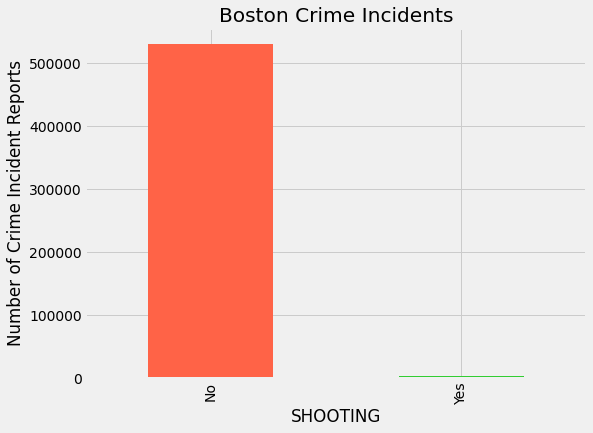

In [22]:
plt.figure(figsize=(8,6))
plot_shooting = bostoncrime['SHOOTING'].value_counts().reindex(['No','Yes']).plot.bar(title='Boston Crime Incidents',color=['tomato','limegreen'])
plot_shooting.set_xlabel('SHOOTING')
plot_shooting.set_ylabel("Number of Crime Incident Reports")

Based on the total amount of crime incidents reports, a small portion of them have involved shootings. 

###Year

Text(0, 0.5, 'Number of Crime Incident Reports')

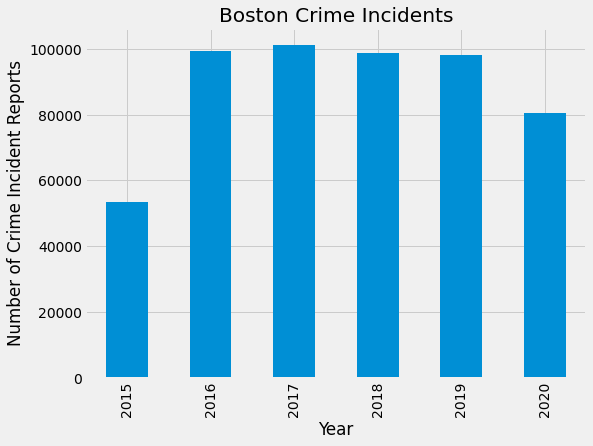

In [23]:
plt.figure(figsize=(8,6))
plot_year = bostoncrime['YEAR'].value_counts().sort_index().plot.bar(title='Boston Crime Incidents')
plot_year.set_xlabel('Year')
plot_year.set_ylabel("Number of Crime Incident Reports")

The year 2015 had significantly fewer incidents, but this was because data began being collected in June, while the other years were full years. Between 2016 and 2019 amounts were relatively similar. The amount of reports in 2020 was significantly less, but the year was not completed upon analysis. Additionally, with the emergence of Covid-19 and stay at home orders, we would expect fewer crime incidents reported.

###Month

Text(0, 0.5, 'Number of Crime Incident Reports')

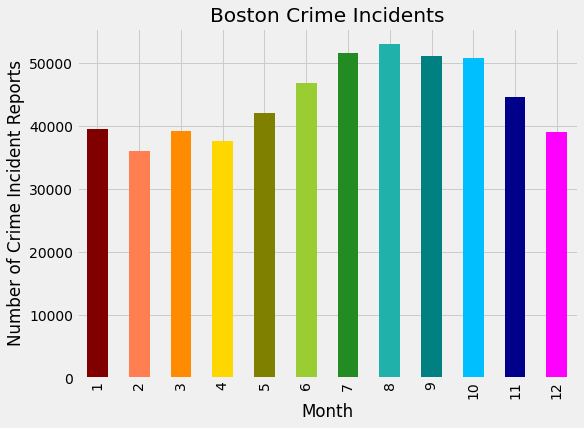

In [24]:
plt.figure(figsize=(8,6))
plot_month = bostoncrime['MONTH'].value_counts().sort_index().plot.bar(title='Boston Crime Incidents',color=['maroon','coral','darkorange','gold','olive','yellowgreen','forestgreen','lightseagreen','teal','deepskyblue','darkblue','magenta'])
plot_month.set_xlabel('Month')
plot_month.set_ylabel("Number of Crime Incident Reports")

The highest amount of crime incident reports have occurred in the months of July through October. One explanation for this might be the daylight hours or the weather.

###Day of the Week

Text(0, 0.5, 'Number of Crime Incident Reports')

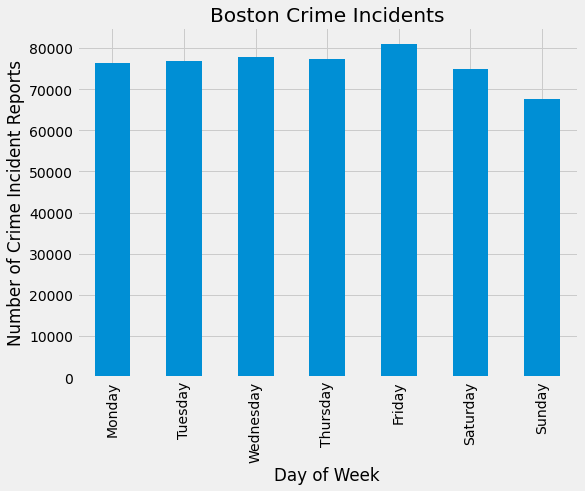

In [25]:
plt.figure(figsize=(8,6))
plot_day = bostoncrime['DAY_OF_WEEK'].value_counts().reindex(['Monday','Tuesday','Wednesday','Thursday','Friday','Saturday','Sunday']).plot.bar(title='Boston Crime Incidents')
plot_day.set_xlabel('Day of Week')
plot_day.set_ylabel("Number of Crime Incident Reports")

The most crime incidents reported have been on Fridays, and the fewest on Sundays. Many people choose to go out on Fridays, and many choose to stay home on Sundays. This could be the reason this pattern is noticeable. Additionally,Monday-Thursday sees a relatively high amount of reports, this could be due to the large amount of people in Boston on working days.

###Hour

Text(0, 0.5, 'Number of Crime Incident Reports')

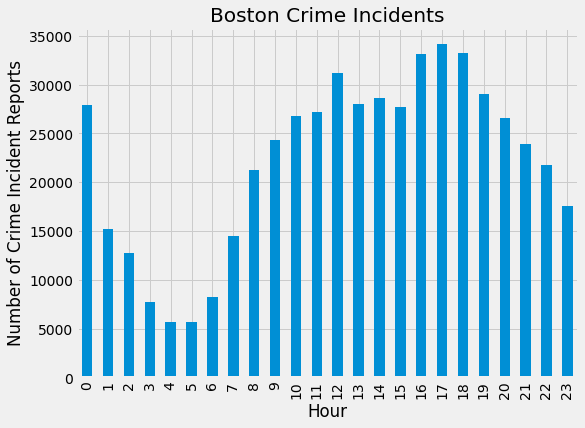

In [26]:
plt.figure(figsize=(8,6))
plot_hour = bostoncrime['HOUR'].value_counts().sort_index().plot.bar(title='Boston Crime Incidents')
plot_hour.set_xlabel('Hour')
plot_hour.set_ylabel("Number of Crime Incident Reports")



As expected, the smallest amount of incidents are reported in the early hours of the morning. This is expected because the amount of people traffic must decrease during these times.

## ***Section 5: Feature Transformation and Creation***
---

###Season Column

In [27]:
#Label incidents into certain seasons
monthlist =[bostoncrime['MONTH']==1,bostoncrime['MONTH']==2,bostoncrime['MONTH']==3,bostoncrime['MONTH']==4,bostoncrime['MONTH']==5,bostoncrime['MONTH']==6,bostoncrime['MONTH']==7,bostoncrime['MONTH']==8,bostoncrime['MONTH']==9,bostoncrime['MONTH']==10,bostoncrime['MONTH']==11,bostoncrime['MONTH']==12]
seasonlist=['Winter','Winter','Spring','Spring','Spring','Summer','Summer','Summer','Fall','Fall','Fall','Winter']

In [28]:
bostoncrime['Season']= np.select(monthlist,seasonlist,'NONE')
bostoncrime.head()

,INCIDENT_NUMBER,OFFENSE_DESCRIPTION,DISTRICT,SHOOTING,OCCURRED_ON_DATE,YEAR,MONTH,DAY_OF_WEEK,HOUR,STREET,Lat,Long,Location,Season
0,TESTTEST2,ASSAULT - AGGRAVATED,External,No,2019-10-16 00:00:00,2019,10,Wednesday,0,RIVERVIEW DR,42.2416,-70.9536,"(0.00000000, 0.00000000)",Fall
1,S97333701,VERBAL DISPUTE,C6,No,2020-07-18 14:34:00,2020,7,Saturday,14,MARY BOYLE WAY,42.3308,-71.0514,"(42.33081300, -71.05136800)",Summer
2,S47513131,THREATS TO DO BODILY HARM,E18,No,2020-06-24 10:15:00,2020,6,Wednesday,10,READVILLE ST,42.2395,-71.136,"(42.23949100, -71.13595400)",Summer
3,I92102201,VERBAL DISPUTE,E13,No,2019-12-20 03:08:00,2019,12,Friday,3,DAY ST,42.3251,-71.1078,"(42.32512200, -71.10777900)",Winter
4,I92097173,INVESTIGATE PERSON,C11,No,2019-10-23 00:00:00,2019,10,Wednesday,0,GIBSON ST,42.2976,-71.0597,"(42.29755500, -71.05970900)",Fall


###Weekend Column

In [29]:
#Label incidents as weekend or weekday
bostoncrime['Weekend'] = np.where(bostoncrime['DAY_OF_WEEK']=='Saturday','Yes',np.where(bostoncrime['DAY_OF_WEEK']=='Sunday','Yes','No'),)
bostoncrime.head()

,INCIDENT_NUMBER,OFFENSE_DESCRIPTION,DISTRICT,SHOOTING,OCCURRED_ON_DATE,YEAR,MONTH,DAY_OF_WEEK,HOUR,STREET,Lat,Long,Location,Season,Weekend
0,TESTTEST2,ASSAULT - AGGRAVATED,External,No,2019-10-16 00:00:00,2019,10,Wednesday,0,RIVERVIEW DR,42.2416,-70.9536,"(0.00000000, 0.00000000)",Fall,No
1,S97333701,VERBAL DISPUTE,C6,No,2020-07-18 14:34:00,2020,7,Saturday,14,MARY BOYLE WAY,42.3308,-71.0514,"(42.33081300, -71.05136800)",Summer,Yes
2,S47513131,THREATS TO DO BODILY HARM,E18,No,2020-06-24 10:15:00,2020,6,Wednesday,10,READVILLE ST,42.2395,-71.136,"(42.23949100, -71.13595400)",Summer,No
3,I92102201,VERBAL DISPUTE,E13,No,2019-12-20 03:08:00,2019,12,Friday,3,DAY ST,42.3251,-71.1078,"(42.32512200, -71.10777900)",Winter,No
4,I92097173,INVESTIGATE PERSON,C11,No,2019-10-23 00:00:00,2019,10,Wednesday,0,GIBSON ST,42.2976,-71.0597,"(42.29755500, -71.05970900)",Fall,No


## ***Section 6: Analysis***
---

###What season has the most crime incidents reported? 

Text(0, 0.5, 'Number of Crime Incident Reports')

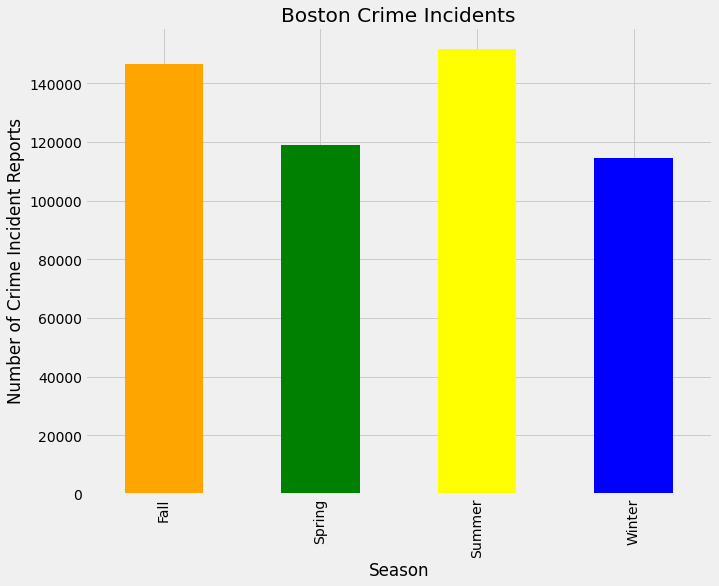

In [30]:
#Plost seasonal incidents
plt.figure(figsize=(10,8))
plot_hour = bostoncrime['Season'].value_counts().sort_index().plot.bar(title='Boston Crime Incidents', color=['orange','green','yellow','blue'])
plot_hour.set_xlabel('Season')
plot_hour.set_ylabel("Number of Crime Incident Reports")

Fall and Summer has the highest amount of crime incident reports. This could be due to hours of daylight and also weather. It is possible that more people are in Boston during these seasons.

### Are crime incidents at specific hours more prevalent in certain seasons?

In [31]:
# Amount of incidents reported at a specific hour in different seasons
bostoncrime.pivot_table(index=['HOUR'], columns=['Season'], values='INCIDENT_NUMBER',
                    aggfunc='count').round(0)

Season,Fall,Spring,Summer,Winter
HOUR,,,,
0,7925,5850,8109,5970
1,4222,3184,4408,3388
2,3391,2679,3819,2839
3,2046,1650,2343,1636
4,1560,1286,1687,1177
5,1547,1256,1671,1182
6,2252,1822,2262,1915
7,4048,3299,3936,3225
8,5958,4660,5927,4714


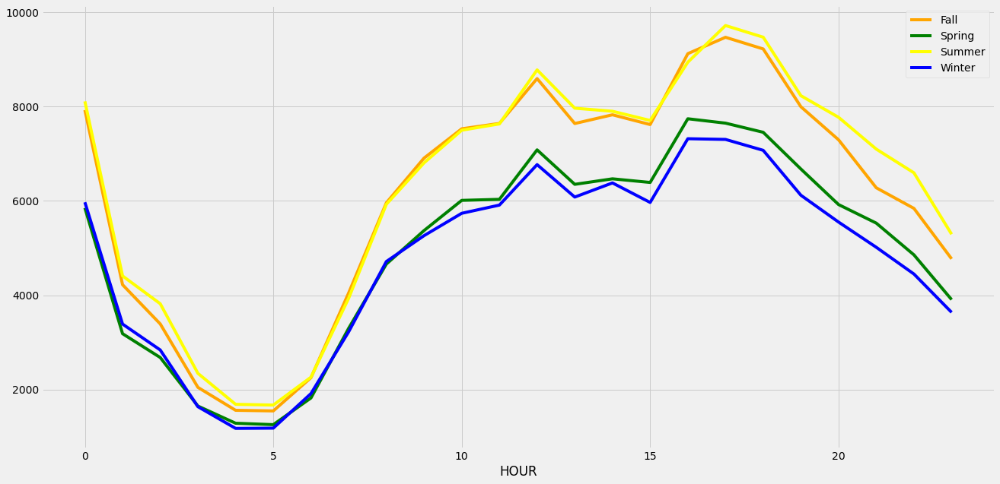

In [32]:
# Plot mount of incidents reported at a specific hour in different seasons
bostoncrime.pivot_table(index=['HOUR'], columns=['Season'], values='INCIDENT_NUMBER',
                    aggfunc='count').round(0).plot(color=['orange','green','yellow','blue'],figsize=(20,10)).legend(loc='best')


There are similar trends in the hours for each season. However, it looks like the difference between Fall and Summer with Spring and Winter diverges greater between the hours of 5 and 20.


### Have different years observed different patterns in terms of monthly counts of crime incident reports?

In [33]:
#Monthly incident report counts for different years
bostoncrime.pivot_table(index=['YEAR'], columns=['MONTH'], values='INCIDENT_NUMBER',
                    aggfunc='count').round(0)

MONTH,1,2,3,4,5,6,7,8,9,10,11,12
YEAR,,,,,,,,,,,,
2015,NaN,NaN,NaN,NaN,NaN,4200.0,8369.0,8395.0,8433.0,8340.0,7838.0,8022.0
2016,7865.0,7339.0,8215.0,8119.0,8594.0,8598.0,8650.0,8967.0,8553.0,8606.0,7945.0,7979.0
2017,8024.0,7429.0,8194.0,8101.0,8745.0,9016.0,9109.0,9251.0,8984.0,8899.0,7983.0,7603.0
2018,7860.0,6997.0,7849.0,8004.0,9072.0,9026.0,8789.0,8871.0,8566.0,8441.0,7694.0,7719.0
2019,7800.0,6930.0,7835.0,7643.0,8687.0,8453.0,8935.0,9248.0,8549.0,8428.0,7835.0,7765.0
2020,7917.0,7359.0,7194.0,5788.0,7071.0,7521.0,7857.0,8290.0,8032.0,8194.0,5358.0,NaN


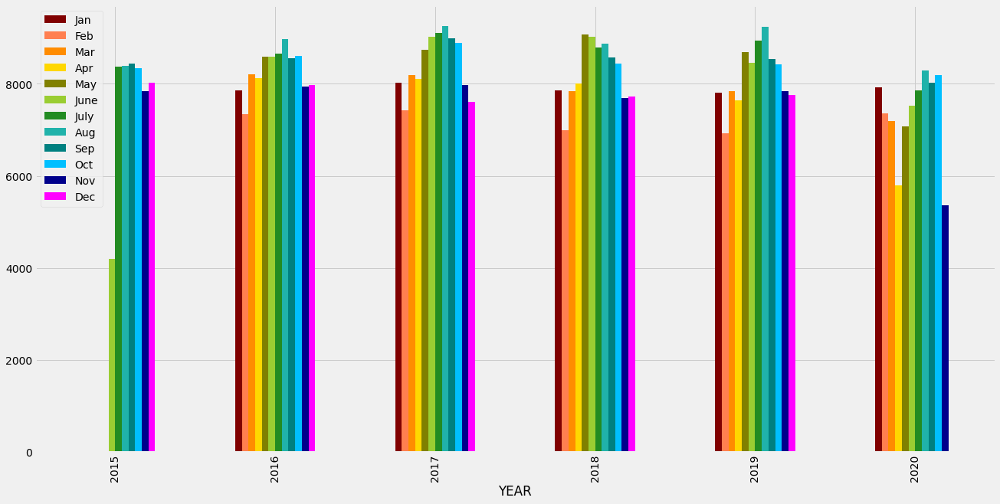

In [34]:
#Plot bar chart of monthly incident report counts for different years
months=['Jan','Feb','Mar','Apr','May','June','July','Aug','Sep','Oct','Nov','Dec']
bostoncrime.pivot_table(index=['YEAR'], columns=['MONTH'], values='INCIDENT_NUMBER',
                    aggfunc='count').round(0).plot(kind="bar",color=['maroon','coral','darkorange','gold','olive','yellowgreen','forestgreen','lightseagreen','teal','deepskyblue','darkblue','magenta'],figsize=(20,10)).legend(loc='best',labels=months)

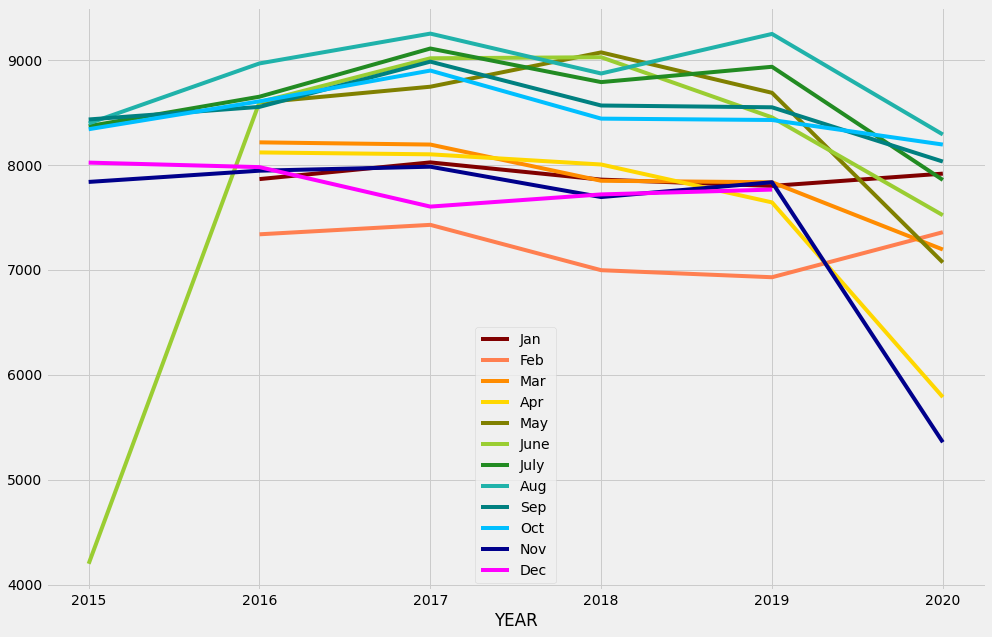

In [35]:
#Plot bar chart of monthly incident report counts for different years
months=['Jan','Feb','Mar','Apr','May','June','July','Aug','Sep','Oct','Nov','Dec']
bostoncrime.pivot_table(index=['YEAR'], columns=['MONTH'], values='INCIDENT_NUMBER', aggfunc='count').round(0).plot(color=['maroon','coral','darkorange','gold','olive','yellowgreen','forestgreen','lightseagreen','teal','deepskyblue','darkblue','magenta'],figsize=(15,10)).legend(loc='best',labels=months)


Monthly trends were relatively similar year over year. 2016,2017, and 2019 were most similar to each other. However, we can see that beginning in March 2020, crime incident reports in 2020 were far fewer and followed a different pattern than previous years. This was expected given the pandemic outbreak.

###Do weekends or weekdays have more crime incidents reported?


Text(0, 0.5, 'Number of Crime Incident Reports')

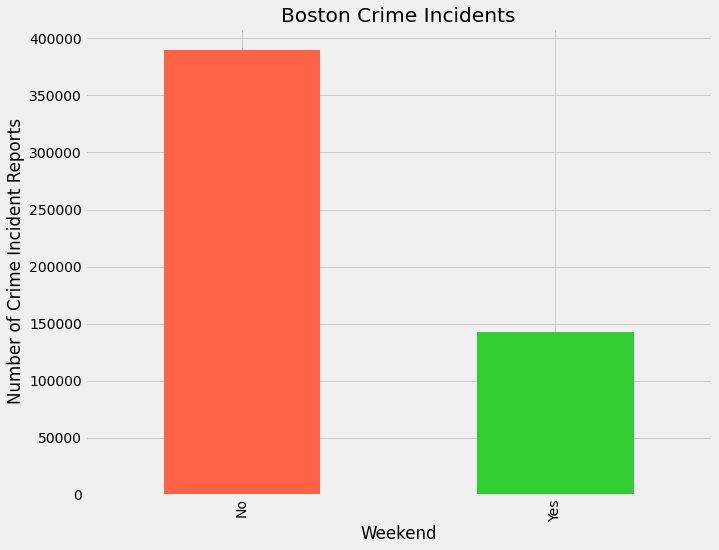

In [36]:
#Plot bar chart of weekday versus weekend incidents
plt.figure(figsize=(10,8))
plot_hour = bostoncrime['Weekend'].value_counts().sort_index().plot.bar(title='Boston Crime Incidents', color=['tomato','limegreen'])
plot_hour.set_xlabel('Weekend')
plot_hour.set_ylabel("Number of Crime Incident Reports")

Majority of the crime incidents reported were on weekdays, but it is important to note that there are only 2 days for the weekend and 5 days for the weekday.

###What areas have the highest or lowest concentration of crime incident reports?

In [37]:
notest = bostoncrime[['Lat','Long']]

In [38]:
crime_map = folium.Map(location=[42.3601, -71.0589], zoom_start=12)
data = [[x[0], x[1], 1] for x in np.array(notest[['Lat', 'Long']])]

In [39]:
boston_coordinates = (42.3601, -71.0589)
gmaps.figure(center=boston_coordinates, zoom_level=12)
HeatMap(data, radius = 10).add_to(crime_map)


In [40]:
display(crime_map)

In [41]:
crime_map.save(outfile= "test.html")

In [42]:

#pic = "/content/drive/MyDrive/Police_Districts-shp"
pic = "/content/drive/MyDrive/Graduate/Python for Business Analytics/Final Project: Boston/Police_Districts-shp"
boston1 = gpd.read_file(pic)

In [43]:
type(boston1)

geopandas.geodataframe.GeoDataFrame

In [44]:
boston1.head(15)

,OBJECTID,DISTRICT,ID,BPDGIS_GIS,DISTRICT_,DISTRICT__,ShapeSTAre,ShapeSTLen,geometry
0,1,A15,A15,A,15,15,3.798392e+07,57616.007190,"MULTIPOLYGON (((771204.900 2967614.950, 771205..."
1,2,A7,A7,A,7,07,1.401151e+08,138468.216080,"MULTIPOLYGON (((792187.300 2969573.400, 792187..."
2,3,A1,A1,A,1,01,4.448484e+07,48957.671219,"POLYGON ((777233.200 2959748.000, 777315.300 2..."
3,4,C6,C6,C,6,06,1.236919e+08,93389.518748,"POLYGON ((779407.000 2954363.800, 779390.500 2..."
4,5,D4,D4,D,4,04,6.999546e+07,41016.808977,"POLYGON ((771263.359 2955490.741, 771418.507 2..."
5,6,D14,D14,D,14,14,1.236253e+08,58025.031627,"POLYGON ((757306.200 2960067.100, 757313.100 2..."
6,7,E13,E13,E,13,13,1.119017e+08,66958.441783,"POLYGON ((760876.381 2946175.581, 760884.029 2..."
7,8,E5,E5,E,5,05,1.916214e+08,87797.653480,"POLYGON ((753345.158 2925394.554, 753346.852 2..."
8,9,B3,B3,B,3,03,9.315897e+07,60468.088955,"POLYGON ((769721.315 2936323.136, 769742.134 2..."
9,10,C11,C11,C,11,11,1.329185e+08,121141.759523,"MULTIPOLYGON (((773840.586 2940789.408, 773836..."


In [45]:
bostondist = bostoncrime['DISTRICT']
bostondist.head()

0    External
1          C6
2         E18
3         E13
4         C11
Name: DISTRICT, dtype: object

In [46]:
sumdist = bostoncrime['DISTRICT'].value_counts(ascending=True)
sumdist

External      116
A15         10849
A7          21797
E5          22979
E13         29380
E18         29844
D14         33795
C6          38263
A1          57485
B3          61418
D4          67582
C11         71645
B2          84322
Name: DISTRICT, dtype: int64

In [47]:
dfsumdist = pd.DataFrame({'DistrictID':['A15','A7','A1','C6','D4','D14','E13','E5','B3','C11','E18','B2'],'Count':[115,21867,57598,38367,67780,33913,29437,23070,61626,71853,29949,84517,]})
dfsumdist

,DistrictID,Count
0,A15,115
1,A7,21867
2,A1,57598
3,C6,38367
4,D4,67780
5,D14,33913
6,E13,29437
7,E5,23070
8,B3,61626
9,C11,71853


In [48]:
merged = pd.concat([boston1,dfsumdist],axis=1,sort=True)

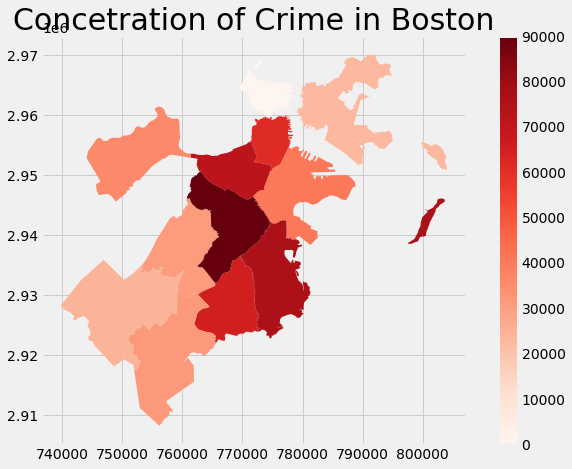

In [49]:
variable = merged['Count']
vmin, vmax = 0,90000
fig,ax = plt.subplots(1, figsize=(10,7))
merged.plot(column=variable, cmap='Reds', linewidth=0.8, ax=ax)
ax.set_title('Concetration of Crime in Boston', fontdict = {'fontsize':'30'})

sm = plt.cm.ScalarMappable(cmap='Reds', norm=plt.Normalize(vmin=vmin, vmax=vmax))
sm._A = []
cbar=fig.colorbar(sm)

## ***Section 7: Conclusion***
---

In conclusion, the safest place for a college student to live would be in either Charlestown or West Roxbury. Both areas have low rates of crime. They are further away from the center of the city. A student needs to be wary in the mid-late afternoon from about 2:00 - 5:00 because that is when the most crimes occured. The summer months are also more dangerous compared to the winter months.